In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Step 2: Install YOLOv8
!pip install ultralytics
# Step 3: Imports
import os
import random
import shutil
from ultralytics import YOLO
import matplotlib.pyplot as plt


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 82.3 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
SOURCE_DIR = "/content/drive/MyDrive/data"  # Original dataset
DEST_DIR = "/content/drive/MyDrive/yolo_cocoa"      # YOLO-ready dataset
classes = ["Fito", "Monilia", "Sana"]
train_ratio = 0.8
random.seed(42)


In [ ]:
for split in ["images/train", "images/val", "labels/train", "labels/val"]:
    os.makedirs(os.path.join(DEST_DIR, split), exist_ok=True)


In [ ]:
for cls in classes:
    cls_path = os.path.join(SOURCE_DIR, cls)
    images = [f for f in os.listdir(cls_path) if f.lower().endswith(('.jpg','.jpeg','.png'))]
    random.shuffle(images)

    split_idx = int(train_ratio * len(images))
    train_imgs = images[:split_idx]
    val_imgs = images[split_idx:]

    # Copy training images and TXT labels
    for img in train_imgs:
        shutil.copy(os.path.join(cls_path, img), os.path.join(DEST_DIR, "images/train", img))
        txt_file = os.path.splitext(img)[0] + ".txt"
        shutil.copy(os.path.join(cls_path, txt_file), os.path.join(DEST_DIR, "labels/train", txt_file))

    # Copy validation images and TXT labels
    for img in val_imgs:
        shutil.copy(os.path.join(cls_path, img), os.path.join(DEST_DIR, "images/val", img))
        txt_file = os.path.splitext(img)[0] + ".txt"
        shutil.copy(os.path.join(cls_path, txt_file), os.path.join(DEST_DIR, "labels/val", txt_file))

    print(f"{cls}: Train={len(train_imgs)}, Val={len(val_imgs)}")


Fito: Train=85, Val=22
Monilia: Train=84, Val=21
Sana: Train=80, Val=20


In [ ]:
yaml_path = "/content/drive/MyDrive/yolo_cocoa/yolo_cocoa.yaml"

yaml_content = """
train: /content/drive/MyDrive/yolo_cocoa/images/train
val: /content/drive/MyDrive/yolo_cocoa/images/val

nc: 3
names: ['Fito','Monilia','Sana']
"""

with open(yaml_path, "w") as f:
    f.write(yaml_content)

print("YAML file created at:", yaml_path)


YAML file created at: /content/drive/MyDrive/yolo_cocoa/yolo_cocoa.yaml


In [ ]:
#Skip this block if you had already trained the model.Run this code only in initial phase.
from ultralytics import YOLO
import os
import shutil

# Load pretrained YOLOv8 nano
model = YOLO("yolov8n.pt")

# Train model
results = model.train(
    data=yaml_path,
    epochs=50,
    imgsz=640,
    batch=8,

    project="/content/drive/MyDrive/yolo_cocoa/runs/train",
    name="cocoa_detection",

    save=True,
    save_period=1,
    plots=True,
    verbose=True
)

# --------------------------------------------------
# EXPORT BEST & LAST MODELS TO A FIXED DRIVE LOCATION
# --------------------------------------------------

# YOLO output directory
weights_dir = "/content/drive/MyDrive/yolo_cocoa/runs/train/cocoa_detection/weights"

# Destination directory (clean & reusable)
export_dir = "/content/drive/MyDrive/yolo_cocoa/models"
os.makedirs(export_dir, exist_ok=True)

# Copy best.pt and last.pt
for w in ["best.pt", "last.pt"]:
    src = os.path.join(weights_dir, w)
    dst = os.path.join(export_dir, w)

    if os.path.exists(src):
        shutil.copy(src, dst)
        print(f"✅ Exported {w} → {dst}")
    else:
        print(f"❌ {w} not found!")


Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/yolo_cocoa/yolo_cocoa.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=cocoa_detection2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, pers

In [ ]:
#Run this block if best model is already stored
from ultralytics import YOLO

model = YOLO("/content/drive/MyDrive/yolo_cocoa/runs/train/cocoa_detection/weights/best.pt")



image 1/1 /content/drive/MyDrive/Final Test/image1.png: 480x640 3 Monilias, 1 Sana, 67.3ms
Speed: 9.4ms preprocess, 67.3ms inference, 58.7ms postprocess per image at shape (1, 3, 480, 640)


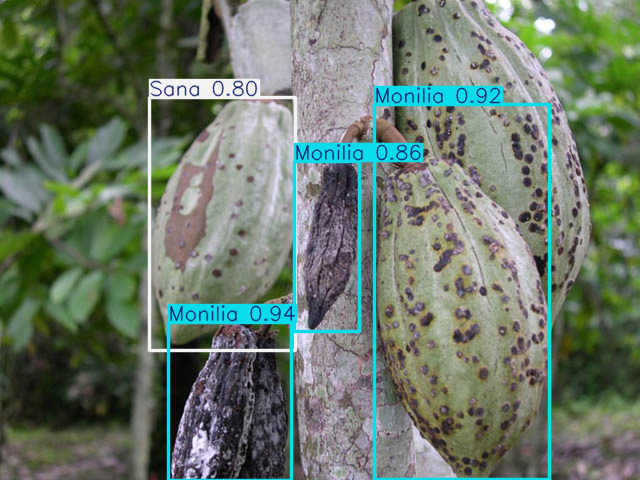

Prediction summary:
[{'name': 'Monilia', 'class': 1, 'confidence': 0.93652, 'box': {'x1': 168.65088, 'y1': 322.0155, 'x2': 291.58093, 'y2': 480.0}}, {'name': 'Monilia', 'class': 1, 'confidence': 0.91888, 'box': {'x1': 374.77753, 'y1': 104.51265, 'x2': 549.91632, 'y2': 479.63531}}, {'name': 'Monilia', 'class': 1, 'confidence': 0.85676, 'box': {'x1': 294.09921, 'y1': 161.19165, 'x2': 359.47189, 'y2': 331.13153}}, {'name': 'Sana', 'class': 2, 'confidence': 0.79849, 'box': {'x1': 149.03308, 'y1': 97.4201, 'x2': 295.60938, 'y2': 350.1088}}]
Detected: Monilia, Confidence: 0.94
Detected: Monilia, Confidence: 0.92
Detected: Monilia, Confidence: 0.86
Detected: Sana, Confidence: 0.80

image 1/1 /content/drive/MyDrive/Final Test/Alfoeldi_ProEcoAfrica_Ghana_Nov2013__117__11.jpg: 480x640 2 Fitos, 3 Sanas, 6.2ms
Speed: 7.3ms preprocess, 6.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


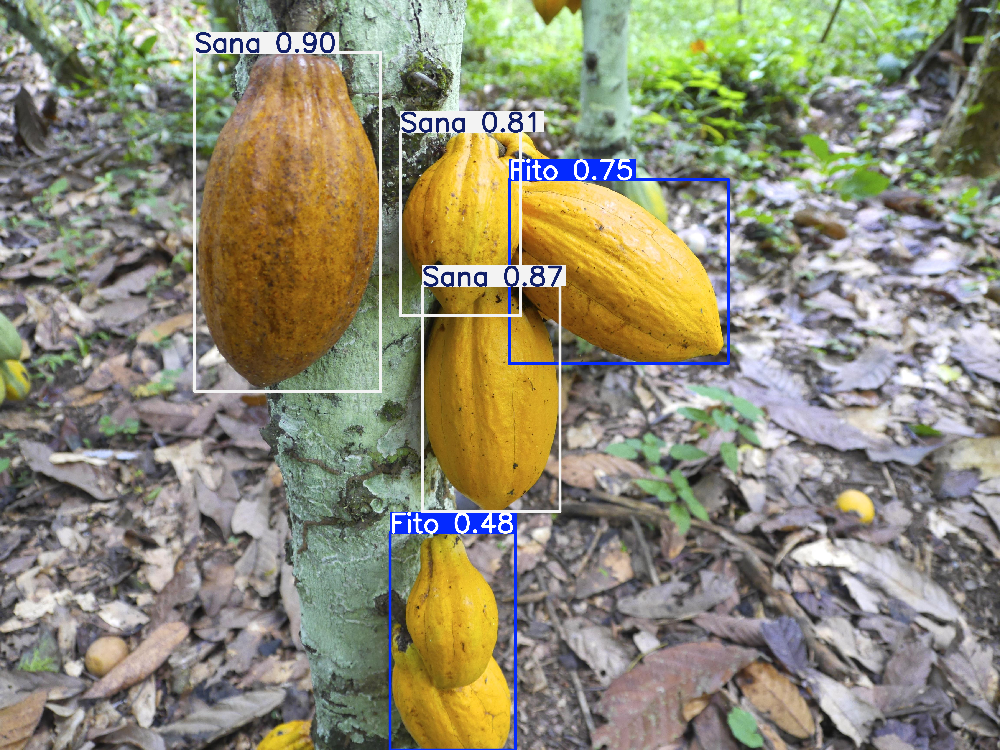

Prediction summary:
[{'name': 'Sana', 'class': 2, 'confidence': 0.90453, 'box': {'x1': 896.31042, 'y1': 240.3295, 'x2': 1754.87854, 'y2': 1803.18469}}, {'name': 'Sana', 'class': 2, 'confidence': 0.86844, 'box': {'x1': 1945.1803, 'y1': 1316.03967, 'x2': 2580.61548, 'y2': 2356.21021}}, {'name': 'Sana', 'class': 2, 'confidence': 0.8061, 'box': {'x1': 1844.16125, 'y1': 606.04163, 'x2': 2398.22021, 'y2': 1455.42456}}, {'name': 'Fito', 'class': 0, 'confidence': 0.75028, 'box': {'x1': 2346.07373, 'y1': 826.10193, 'x2': 3356.25122, 'y2': 1674.68994}}, {'name': 'Fito', 'class': 0, 'confidence': 0.48461, 'box': {'x1': 1797.13513, 'y1': 2454.52295, 'x2': 2375.18262, 'y2': 3456.0}}]
Detected: Sana, Confidence: 0.90
Detected: Sana, Confidence: 0.87
Detected: Sana, Confidence: 0.81
Detected: Fito, Confidence: 0.75
Detected: Fito, Confidence: 0.48

image 1/1 /content/drive/MyDrive/Final Test/Screenshot 2026-01-11 150900.jpg: 480x640 8 Sanas, 11.8ms
Speed: 7.8ms preprocess, 11.8ms inference, 3.7ms pos

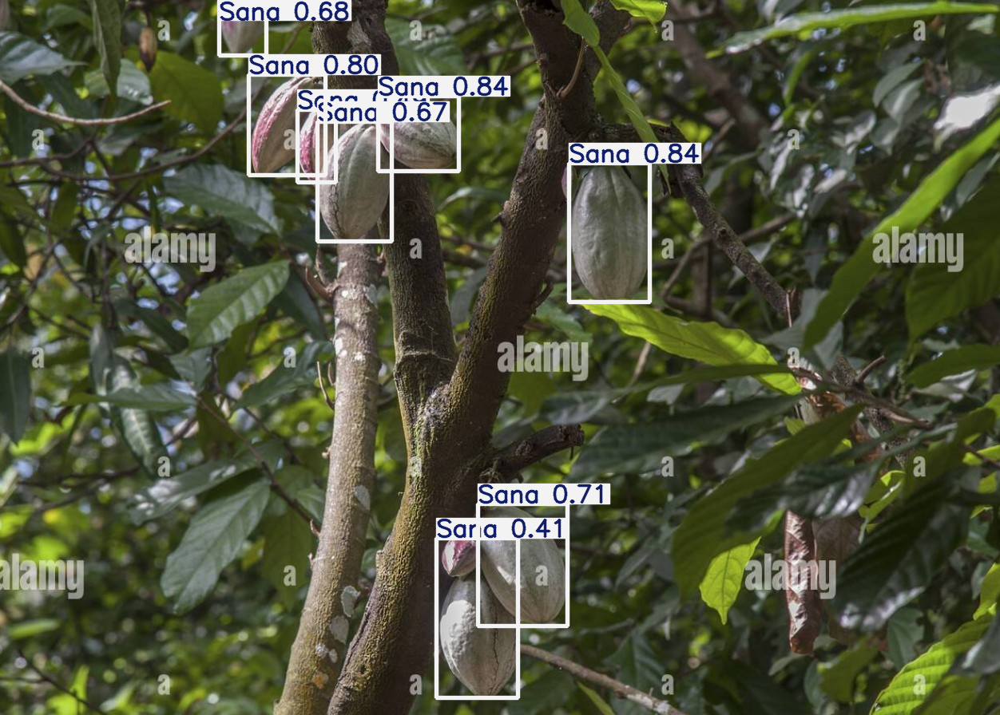

Prediction summary:
[{'name': 'Sana', 'class': 2, 'confidence': 0.8382, 'box': {'x1': 473.00208, 'y1': 120.43343, 'x2': 574.52435, 'y2': 214.50485}}, {'name': 'Sana', 'class': 2, 'confidence': 0.83606, 'box': {'x1': 712.83722, 'y1': 204.13763, 'x2': 813.42639, 'y2': 378.0083}}, {'name': 'Sana', 'class': 2, 'confidence': 0.79942, 'box': {'x1': 311.39154, 'y1': 93.01485, 'x2': 407.22501, 'y2': 219.70229}}, {'name': 'Sana', 'class': 2, 'confidence': 0.70562, 'box': {'x1': 598.59479, 'y1': 631.31952, 'x2': 710.62549, 'y2': 784.30267}}, {'name': 'Sana', 'class': 2, 'confidence': 0.68223, 'box': {'x1': 274.59723, 'y1': 0.0, 'x2': 333.30072, 'y2': 69.65297}}, {'name': 'Sana', 'class': 2, 'confidence': 0.67295, 'box': {'x1': 397.7879, 'y1': 152.22826, 'x2': 490.66501, 'y2': 302.35568}}, {'name': 'Sana', 'class': 2, 'confidence': 0.48758, 'box': {'x1': 372.73804, 'y1': 137.42172, 'x2': 420.12753, 'y2': 228.99727}}, {'name': 'Sana', 'class': 2, 'confidence': 0.41177, 'box': {'x1': 546.8783, 'y1'

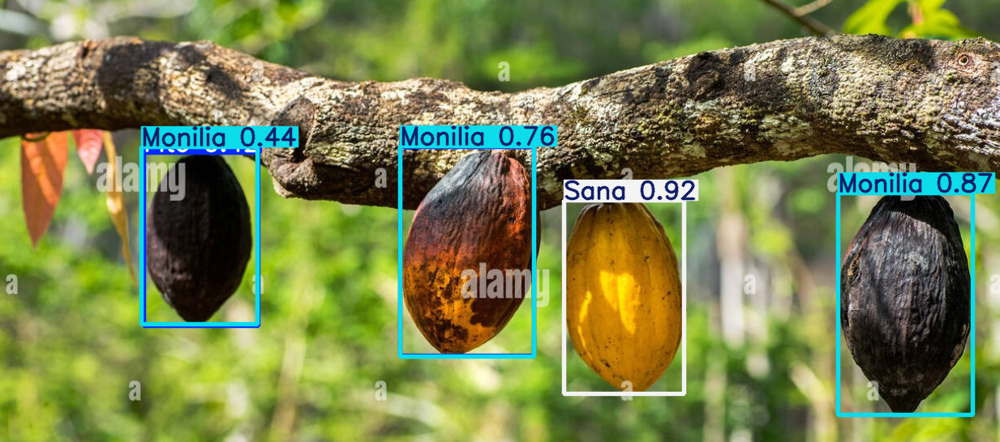

Prediction summary:
[{'name': 'Sana', 'class': 2, 'confidence': 0.92102, 'box': {'x1': 695.0705, 'y1': 247.92422, 'x2': 843.46008, 'y2': 486.8222}}, {'name': 'Monilia', 'class': 1, 'confidence': 0.87395, 'box': {'x1': 1033.14697, 'y1': 238.56985, 'x2': 1199.8374, 'y2': 512.19305}}, {'name': 'Monilia', 'class': 1, 'confidence': 0.75529, 'box': {'x1': 493.48804, 'y1': 180.09615, 'x2': 658.70972, 'y2': 440.55008}}, {'name': 'Monilia', 'class': 1, 'confidence': 0.44416, 'box': {'x1': 174.58194, 'y1': 181.84056, 'x2': 317.27777, 'y2': 400.32822}}, {'name': 'Fito', 'class': 0, 'confidence': 0.43093, 'box': {'x1': 493.00113, 'y1': 181.29079, 'x2': 658.30035, 'y2': 439.32224}}, {'name': 'Fito', 'class': 0, 'confidence': 0.41688, 'box': {'x1': 177.70863, 'y1': 188.63258, 'x2': 318.27014, 'y2': 402.05804}}]
Detected: Sana, Confidence: 0.92
Detected: Monilia, Confidence: 0.87
Detected: Monilia, Confidence: 0.76
Detected: Monilia, Confidence: 0.44
Detected: Fito, Confidence: 0.43
Detected: Fito, C

In [ ]:
import os
import cv2

test_dir = "/content/drive/MyDrive/Final Test"
export_dir = "/content/drive/MyDrive/Test_Predictions"
os.makedirs(export_dir, exist_ok=True)

test_images = [
    os.path.join(test_dir, f)
    for f in os.listdir(test_dir)
    if f.lower().endswith(('.jpg', '.jpeg', '.png'))
]

for img_path in test_images:   # ✅ ALL images
    results = model.predict(img_path, conf=0.25)
    r = results[0]

    # Save annotated image
    annotated_img = r.plot()   # numpy array (BGR)

    base = os.path.basename(img_path)
    name, ext = os.path.splitext(base)
    save_path = os.path.join(export_dir, f"{name}_2{ext}")

    cv2.imwrite(save_path, annotated_img)

    # Optional: show in Colab
    r.show()

    # Optional: print summary
    print("Prediction summary:")
    print(r.summary())

    # Optional: print detected classes
    if r.boxes is not None:
        for box in r.boxes:
            cls_idx = int(box.cls[0])
            conf = float(box.conf[0])
            print(f"Detected: {classes[cls_idx]}, Confidence: {conf:.2f}")


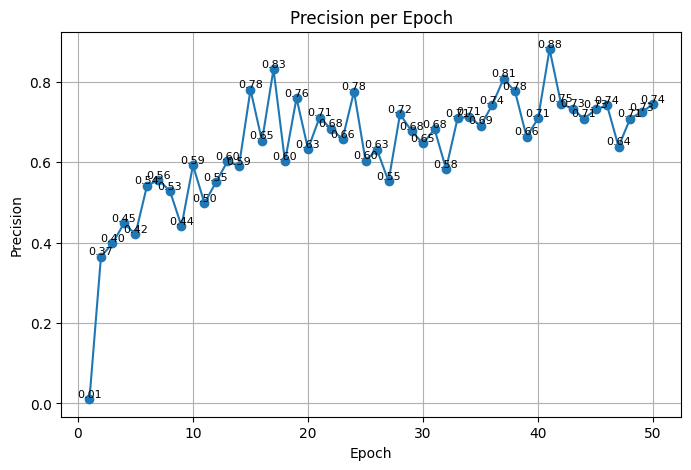

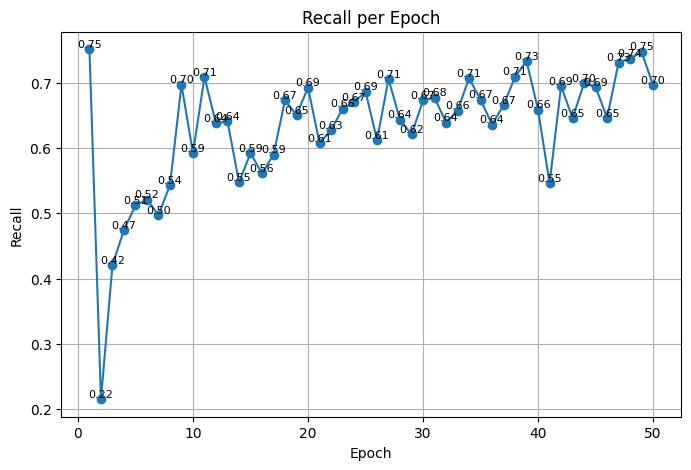

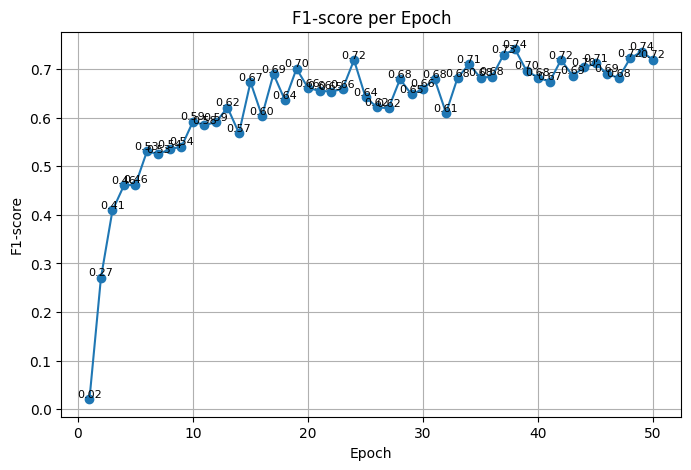

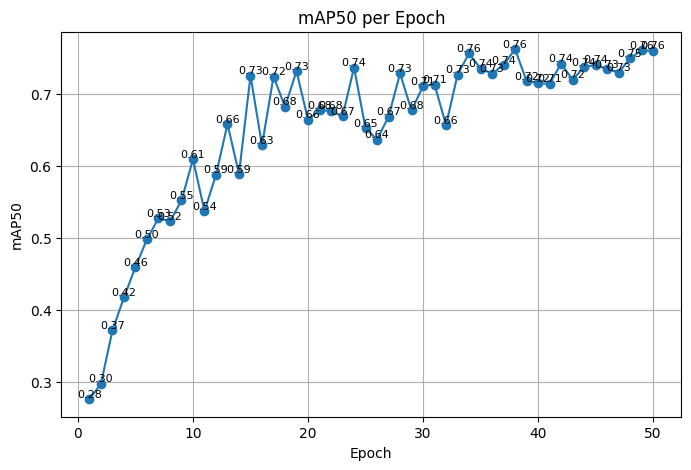

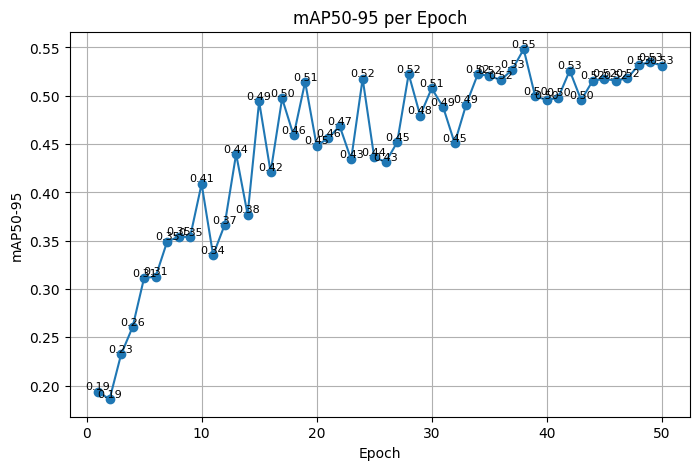

✅ All charts exported to: /content/drive/MyDrive/yolo_cocoa/metric_charts


In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Paths
csv_path = "/content/drive/MyDrive/yolo_cocoa/runs/train/cocoa_detection/results.csv"
export_dir = "/content/drive/MyDrive/yolo_cocoa/metric_charts"
os.makedirs(export_dir, exist_ok=True)

# Load CSV
df = pd.read_csv(csv_path)
df.columns = df.columns.str.strip()

# Compute F1-score
df["F1"] = 2 * (df["metrics/precision(B)"] * df["metrics/recall(B)"]) / (
    df["metrics/precision(B)"] + df["metrics/recall(B)"] + 1e-6
)

metrics = {
    "Precision": "metrics/precision(B)",
    "Recall": "metrics/recall(B)",
    "F1-score": "F1",
    "mAP50": "metrics/mAP50(B)",
    "mAP50-95": "metrics/mAP50-95(B)"
}

for title, col in metrics.items():
    plt.figure(figsize=(8, 5))
    plt.plot(df["epoch"], df[col], marker="o")

    # Label each epoch value
    for x, y in zip(df["epoch"], df[col]):
        plt.text(x, y, f"{y:.2f}", ha="center", va="bottom", fontsize=8)

    plt.xlabel("Epoch")
    plt.ylabel(title)
    plt.title(f"{title} per Epoch")
    plt.grid(True)

    # ---- EXPORT FIGURE ----
    save_path = os.path.join(export_dir, f"{title.replace(' ', '_')}.png")
    plt.savefig(save_path, dpi=300, bbox_inches="tight")

    plt.show()
    plt.close()

print(f"✅ All charts exported to: {export_dir}")
